# **TP1 : Détection, Description et Mtchings des points d'intérêt.**

- **Nom**    : $Branis$  
- **Prénom** : $GHOUL$  
- **id**     : $28612738$  
- **Master** : $ISI$  

## Objectif : 
Dans ce TP, nous allons implementer et étudier le fonctionnement (influence des paramétres, limitations, variantes) de deux détectecteurs
de points d'intérêts **$Harris$** et **$FAST$** et d’un descripteur simple dans l’optique de réaliser une application de panorama. L’implémentation est faite en Python.

# Importation des librairies nécessaires 

In [1]:
# Importer les librairies nécessaire
from skimage.io import imread
from skimage.color import rgb2gray
import numpy as np
import cv2
from matplotlib.patches import ConnectionPatch
import matplotlib.pyplot as plt 
%matplotlib inline

import sys
import os 
from utils import *
from Harris import *
from FAST import *
from matching import *
from LBP import *

# Visualisation des images à traiter

In [2]:
# Importer des images et les stockées dans une liste. 
current_directory = os.path.dirname(os.path.abspath('__file__'))
full_path_images = os.path.join(current_directory, 'Docs_Primitives', 'pics')
images = [imread(os.path.join(full_path_images, img)) 
          for img in os.listdir(full_path_images) if img.endswith(('JPG', 'PNG'))]
targets = [img for img in os.listdir(full_path_images) if img.endswith(('JPG', 'PNG'))]

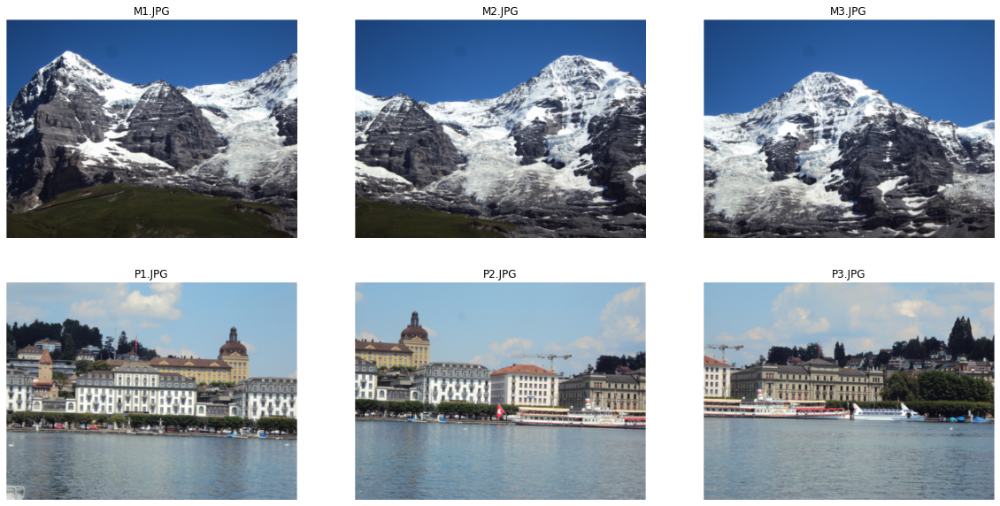

In [3]:
# Afficher les images. 
show_images(images, targets, nb_images=len(images), grid=False, total_cols=3, figsize=(20, 10)) 

# EXERCICE 1: DETECTION DE POINTS D’INTERÉT
L’objectif de cet exercice est d’implementer et d’étudier deux algorithmes de détection de points d’intérét.

### $1.$ Detecteur de Harris :


$(a.1)$ Implementer le détecteur de Harris en utilisant une fenétre de pondération rectangulaire.

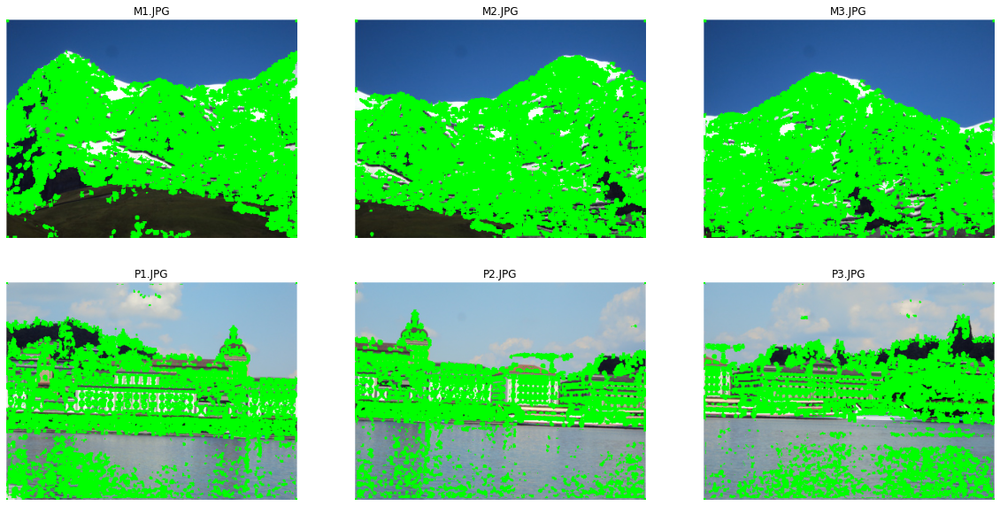

In [4]:
# Estimation de points d'intérêts de toutes les images
all_harris_corners_images = [harris(img_gray=img.copy(), filter='Rectangle', supression=False, truncate=0.61)[0] for img in images]
# Colorer les pints d'intérêt dans chaque image 
images_cornes = coloring_points_interest(all_harris_corners_images, images)
# Affichage des images 
show_images(images_cornes, targets, nb_images=len(images_cornes), grid=False, total_cols=3, figsize=(20, 10))

$(a.2)$ Implementer le détecteur de Harris en utilisant une fenétre de pondération gaussienne.

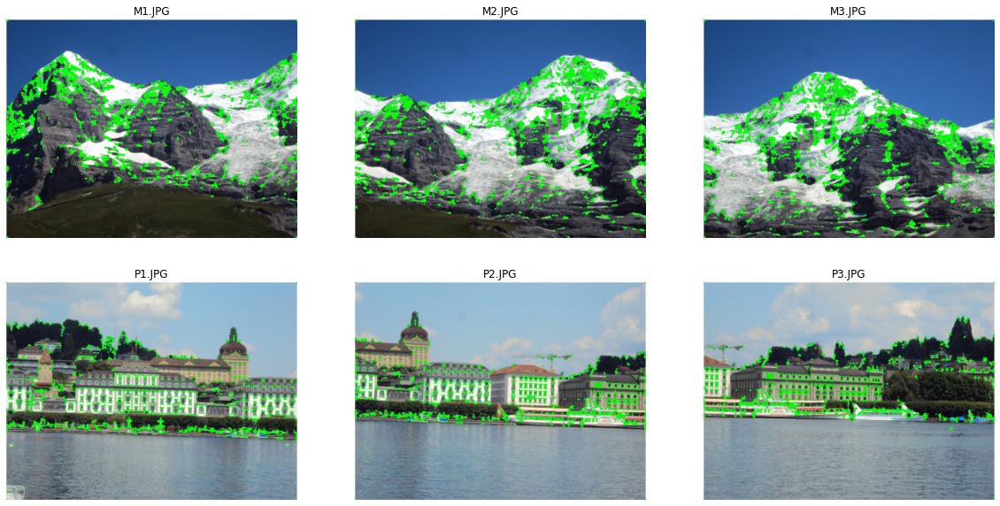

In [5]:
# Estimation de points d'intérêts de toutes les images
all_harris_corners_images = [harris(img_gray=img.copy(), filter='Gaussian', supression=False, truncate=0.61)[0] for img in images]
# Colorer les pints d'intérêt dans chaque image 
images_cornes = coloring_points_interest(all_harris_corners_images, images)
# Affichage des images 
show_images(images_cornes, targets, nb_images=len(images_cornes), grid=False, total_cols=3, figsize=(20, 10))

$(b)$ Implementer également une suppression des non-maxima locaux afin d'éviter les ”amas” de points d’intérét. 

- Suppression des non-maxima locaux avec le filtre $Rectangle$

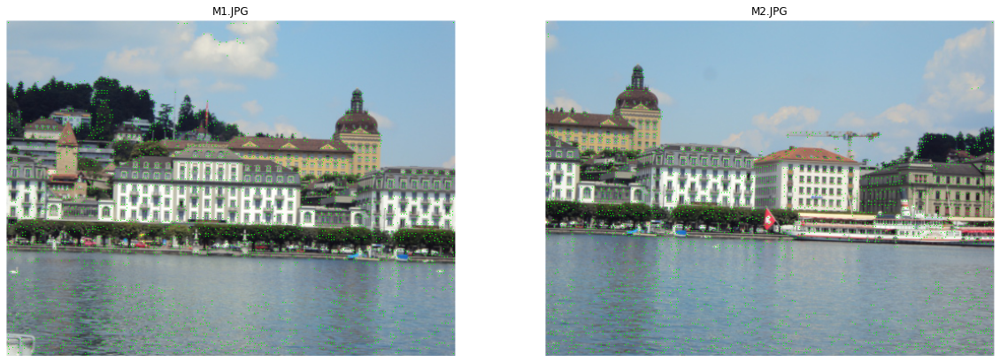

In [6]:
# Estimation de points d'intérêts de toutes les images
all_harris_corners_images = [harris(img_gray=img.copy(), filter='Rectangle', supression=True, truncate=0.61)[0] for img in images[3:5]]
# Colorer les points d'intérêt dans chaque image 
images_cornes = coloring_points_interest(all_harris_corners_images, images[3:5])
# Affichage des images 
show_images(images_cornes, targets, nb_images=len(images_cornes), grid=False, total_cols=2, figsize=(20, 10))

- Suppression des non-maxima locaux avec le filtre $Gaussien$

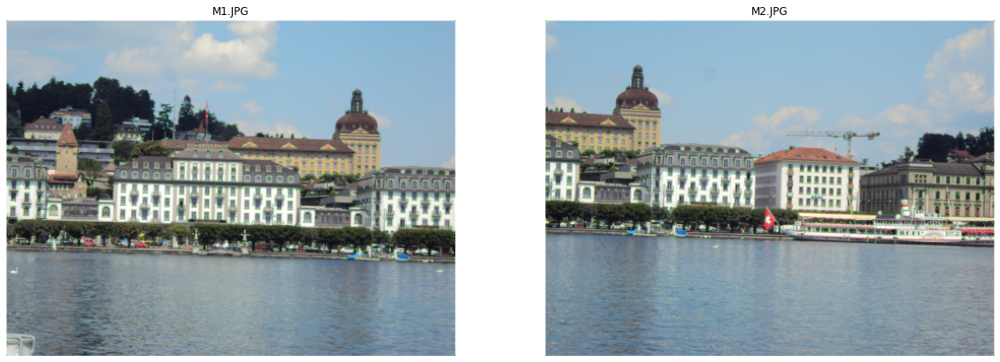

In [7]:
# Estimation de points d'intérêts de toutes les images
all_harris_corners_images = [harris(img_gray=img.copy(), filter='Gaussian', supression=True,truncate=0.61)[0] for img in images[3:5]]
# Colorer les points d'intérêt dans chaque image 
images_cornes = coloring_points_interest(all_harris_corners_images, images[3:5])
# Affichage des images 
show_images(images_cornes, targets, nb_images=len(images_cornes), grid=False, total_cols=3, figsize=(20, 10))

$(c)$ Etudier l’influence du type de fenétre de pondération, de sa taille ainsi que du paramétre $k$ dans la detection de point dinterét.

**L'influance du type de fenêtre** :  

- $Rectangulaire$ :  
En pondérant notre image avec un filtre rectangulaire, et malgré l'application d'une suppression non maximal des amas. Le détecteur renvoie un nombre important de points, la raison est que ces deniers ne sont pas seulement des coins, mais aussi des bords et des fois des zones homogènes. En plus de cela, il s'avère que une convolution d'une image avec un filtre rectangulaire prend un plus de temps que une convolution avec une fenêtre gaussienne.
    - Mauvaise précisons.  
    - Temps de calcule important.  


- $Gaussienne$ :  
En pondérant notre image avec un filtre gaussien. Le détecteur renvoie un nombre acceptable de points (cela dépond aussi de la taille de la fenêtre de la suppression non maximal et le pâramètre $k$), la raison est que ces deniers sont effectivement des coins. En plus de cela, l'exécution de la convolution est presque instantané.
    - Meilleure précision.
    - Exécution casi instantanée.

**L'influence de la taille de la fenêtre** :  
Pour visualiser l'influence de la taille de la fenêtre de pondération sur la détection des points d'intérêt, nous allons tous simplement pondérer une image avec une gaussienne de taille $(3, 3)$, $(5, 5)$ et $(7, 7)$. Avec un écart type $\sigma  = 5/6$ fixe.
 

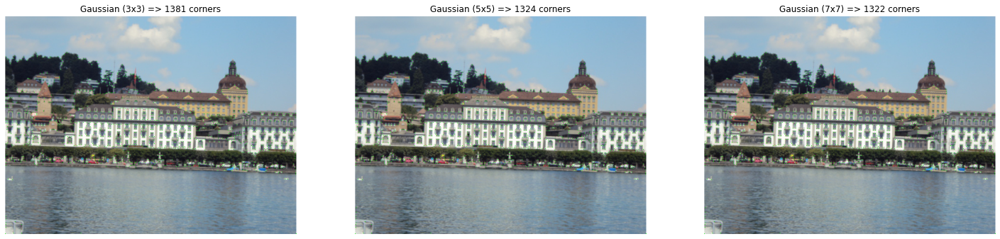

In [8]:
# Récuperer une image
img = images[3].copy()
img_3x3, corners_3x3 = harris(img_gray=img, filter='Gaussian', supression=True, truncate=0.61)
img_5x5, corners_5x5 = harris(img_gray=img, filter='Gaussian', supression=True, truncate=1.81)
img_7x7, corners_7x7 = harris(img_gray=img, filter='Gaussian', supression=True, truncate=3.10)

# Colorer les points d'intérêt
coloring_corners = coloring_points_interest([img_3x3, img_5x5, img_7x7], [img, img, img])

# Affichage des résultats
show_images(coloring_corners, [ 'Gaussian (3x3) => ' + str(len(corners_3x3)) + ' corners', 
                                'Gaussian (5x5) => ' + str(len(corners_5x5)) + ' corners',
                                'Gaussian (7x7) => ' + str(len(corners_7x7)) + ' corners'], 
                                nb_images=3, grid=False, total_cols=3, figsize=(25, 15))

En augmentant la taille de la fenêtre de pondération, le détecteur renvoie moins de points d'intérêt, donc plus précis. La raison est que à chaque fois la taille de la fenêtre est importante on prend en considération plusieurs pixels autour du pixel à convoluer. Autrement dit, le détecteur possède plus d'informations sur ce dernier. 

**L'influance du paramétre $k$ dans la détection de point d'intérêt** :  
Pour visualiser l'influence du paramétre $k$ dans la détection de point d'intérêt, nous allons tous simplement varier $k$ de `$0.04, 0.05, 0.06$`. Avec $\sigma = 5/6$ et une denêtre de ponération $gaissienne$ de $(5, 5)$

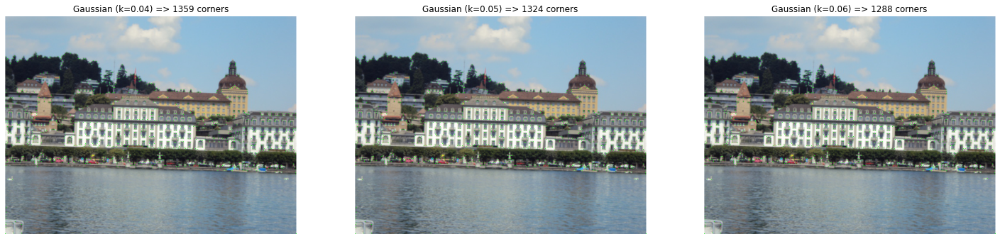

In [9]:
# Récuperer une image
img = images[3].copy()

img_k_04, corners_k_04 = harris(img_gray=img, filter='Gaussian', supression=True, truncate=1.81, k=0.04)
img_k_05, corners_k_05 = harris(img_gray=img, filter='Gaussian', supression=True, truncate=1.81, k=0.05)
img_k_06, corners_k_06 = harris(img_gray=img, filter='Gaussian', supression=True, truncate=1.81, k=0.06)

# Colorer les points d'intérêt
coloring_corners = coloring_points_interest([img_k_04, img_k_05, img_k_06], [img, img, img])

# Affichage des résultats
show_images(coloring_corners, [ 'Gaussian (k=0.04) => ' + str(len(corners_k_04)) + ' corners', 
                                'Gaussian (k=0.05) => ' + str(len(corners_k_05)) + ' corners',
                                'Gaussian (k=0.06) => ' + str(len(corners_k_06)) + ' corners'], 
                                nb_images=3, grid=False, total_cols=3, figsize=(25, 15))

En augmentant la valeur du paramètre $k$, les points d'intérêt renvoyés par le détecteur diminue fortement. cela est très utile lorsque nous voulant diminuer le nombre de points à détecter et garder la taille des fenêtres de pondération et de suppression maximal fixe, probablement pour l'optimisation de calcule ou autres.

$(d)$ Utiliser les fonctions existantes de Matlab ou Python pour effectuer une rotation de l’image. Les points d’interét détectés
sur cette image tournee sont-ils les mêmes que ceux de l’image originale ? Quel paramêtre faut-il adapter pour que cela soit le cas ?

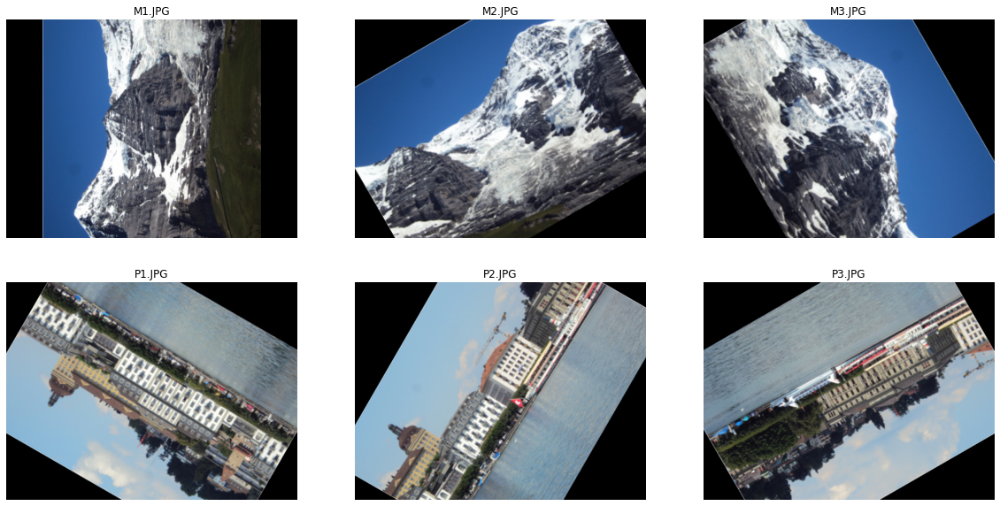

In [34]:
# Générer des images en rotation 
images_rotated = [rotate_img(image=image, angle=np.random.choice([30, 60, 90, 120, 150, 180, 210, 240, 270, 300]), scale=1) for image in images]
# Affichage des images 
show_images(images_rotated, targets, nb_images=len(images_rotated), grid=False, total_cols=3, figsize=(20, 10))

- Détection des points d'intérêt des images en rotation avec le filtre $Rectangle$

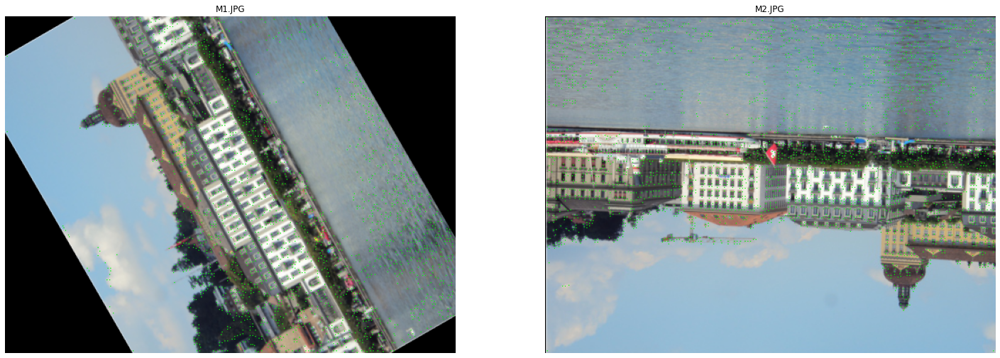

In [11]:
# Estimation de points d'intérêts de toutes les images
all_harris_corners_images = [harris(img_gray=img.copy(), filter='Rectangle', supression=True)[0] for img in images_rotated[3:5]]
# Colorer les pints d'intérêt dans chaque image 
images_cornes = coloring_points_interest(all_harris_corners_images, images_rotated[3:5])
# Affichage des images 
show_images(images_cornes, targets, nb_images=len(images_cornes), grid=False, total_cols=3, figsize=(25, 15))

- Détection des points d'intérêt des images en rotation avec le filtre $Gaussian$

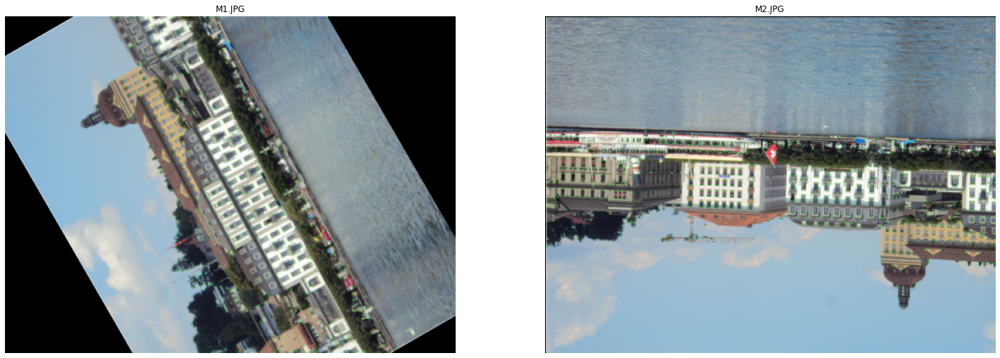

In [12]:
all_harris_corners_images = [harris(img_gray=img.copy(), filter='Gaussian', supression=True)[0] for img in images_rotated[3:5]]
# Colorer les pints d'intérêt dans chaque image 
images_cornes = coloring_points_interest(all_harris_corners_images, images_rotated[3:5])
# Affichage des images 
show_images(images_cornes, targets, nb_images=len(images_cornes), grid=False, total_cols=3, figsize=(25, 15))

- Détecteur de Harris pondérer avec une fenêtre $Réctangulaire$ :  
    - Invariant à la translation
    - variant par rotation

- Détecteur de Harris pondérer avec une fenêtre $Gaussienne$ :  
    - Invariant à la translation  
    - Invariant par rotation 

# 2. Detecteur FAST :

$(a)$ Implementer le détecteur FAST.  
Pour verifier si $n$ points consecutifs sont à 1, vous pouvez soit utiliser la fonction  `circshift` de Matlab (ou son
equivalent en Python), soit convoluer votre vecteur par un filtre de taille $n$ rempli de 1.

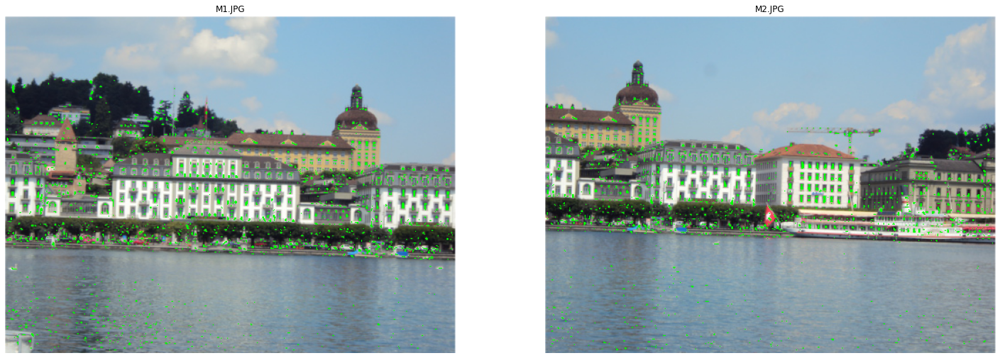

In [13]:
all_FAST_corners_images = [fast(img_gray=img.copy(), suppress=False, k_size=(3, 3))[0] for img in images[3:5]]
# Colorer les pints d'intérêt dans chaque image 
images_cornes = coloring_points_interest(all_FAST_corners_images, images[3:5])
# Affichage des images 
show_images(images_cornes, targets, nb_images=len(images_cornes), grid=False, total_cols=2, figsize=(25, 15))

$(b)$ Implementer la suppression des non-maxima locaux. Quelle score utilisé pour cette suppression ?

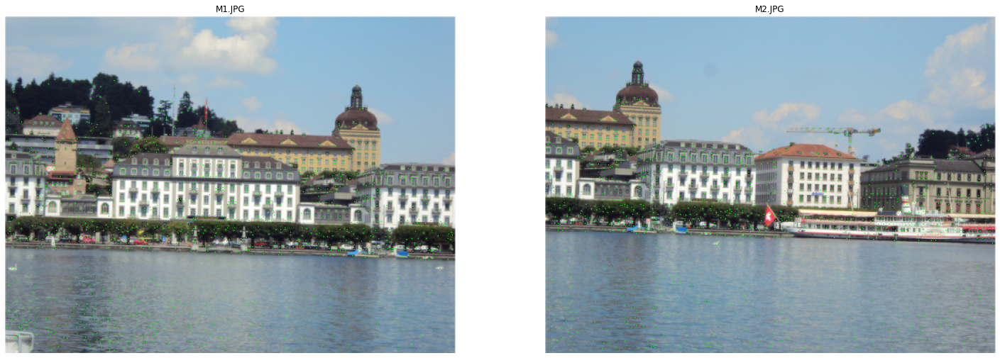

In [14]:
all_FAST_corners_images = [fast(img_gray=img.copy(), suppress=True, k_size=(3, 3))[0] for img in images[3:5]]
# Colorer les pints d'intérêt dans chaque image 
images_cornes = coloring_points_interest(all_FAST_corners_images, images[3:5])
# Affichage des images 
show_images(images_cornes, targets, nb_images=len(images_cornes), grid=False, total_cols=3, figsize=(25, 15))

**Le score utilisé pour cette suppression** :   
Le score d'un point d'intérêt est défini comme la somme de la différence absolue entre les intensités de tous les points appartenant au cercle qui entour le pixel centrale de rayon $3$ et l'intensité du pixel central. 

$(c)$ Utiliser les fonctions existantes de Matlab ou Python pour effectuer une rotation de l’image. Les points d’interé et détectés
sur cette image tournee sont-ils les mêmes que ceux de l’image originale ? Quel paramêtre faut-il adapter pour que cela soit le cas ?

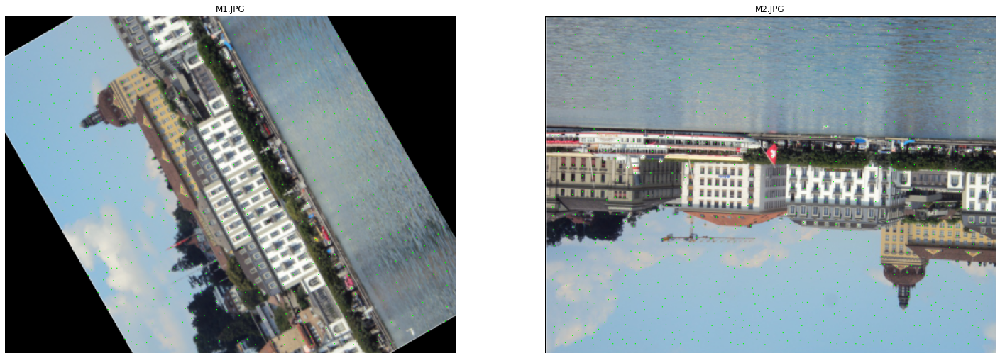

In [15]:
all_FAST_corners_images = [fast(img_gray=img.copy()*255.0, suppress=True, k_size=(9, 9))[0] for img in images_rotated[3:5]]
# Colorer les pints d'intérêt dans chaque image 
images_cornes = coloring_points_interest(all_FAST_corners_images, images_rotated[3:5])
# Affichage des images 
show_images(images_cornes, targets, nb_images=len(images_cornes), grid=False, total_cols=3, figsize=(25, 15))

Les points d'intérêt détecter avec FAST sont les même lorsque en applique des rotation ou des translation.  
Donc FAST est :   
    - Invariant par Translation.  
    - Invariant par Rotation.  

**Remarque** :  
Le détecteur FAST est variant à l'échelle. Pour y remédier à ce problème, différentes solutions algorithmiques s'offre à nous:  
    - Méthode de $HOG$.  
    - ...  

# 3. Comparaison :


$(a)$ Comparer les points d’interét détectées par le détecteur de Harris et par le détecteur FAST. Quelle(s) différence(s) obeservez-vous ?

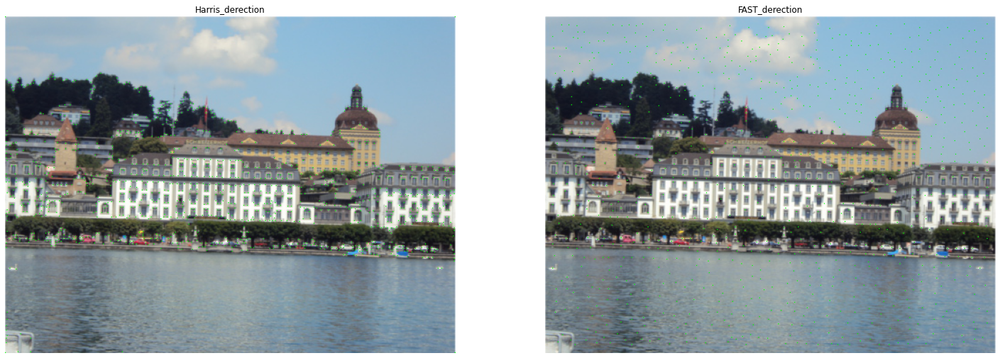

In [16]:
Harris_derection, _ = harris(img_gray=images[3].copy(), filter='Gaussian', supression=True)
FAST_detection, _ = fast(img_gray=images[3].copy()*255.0, suppress=True, k_size=(9, 9))
# Colorer les pints d'intérêt dans chaque image 
images_cornes = coloring_points_interest([Harris_derection, FAST_detection], [images[3], images[3]])
show_images(images_cornes, targets=['Harris_derection', 'FAST_derection'], nb_images=len(images_cornes), grid=False, total_cols=2, figsize=(25, 15))

**Fast:**
- Avantages :
    - Comme son nom l'indique, $Fast$ est développé pour la détection des points d'intérêt en temps réel.
    - Invariant par rotation.
    - Invariant par translation
- Inconvénients :
    - Variant au changement d'échelle.
    - Variant au changement d'intensités.    
    - Difficile de choisir les paramètres $n$, $t$.     
    - Pour $n<12$, le détecteur n'est pas très efficace (mauvaises précisions).  

**Harris:**  
- Avantages :  
    - Précision.  
    - Stabilité.  
    - Invariant en rotation, (avec une fenêtre de pondération gaussienne).  
- Inconvénients :     
    - Temps d'exécution important.    
    - Variant au changement d'échelle.      
    - Variant au changement d'intensités.   



$(b)$ $(Bonus)$ Utiliser les fonctions existantes de Matlab ou de Python pour comparer vos detecteurs à ceux déjà implémentés (Harris, FAST ou d’autres)

- Détecteur **FAST** avec **OpenCv** 

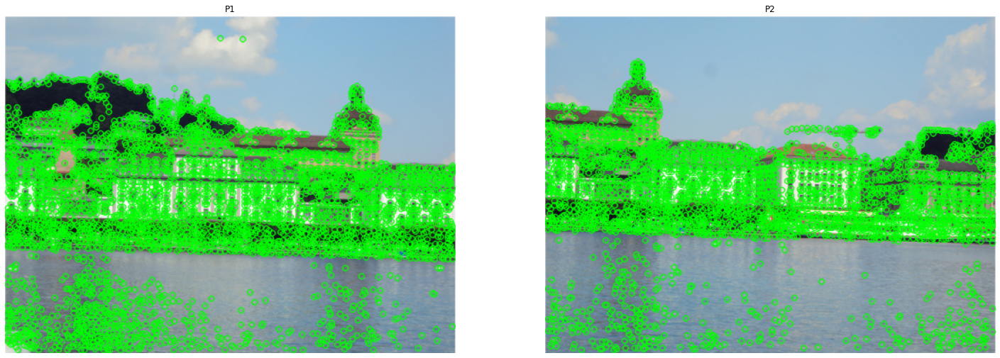

In [17]:
# Créé une instance FAST en utilisant les paramètres par défaut 
fast_ = cv2.FastFeatureDetector_create()
# Estimet les points d'intérêt des images 
list_kp = [fast_.detect(img.copy(), None) for img in images[3:5]]
fast_detection_cv2 = [cv2.drawKeypoints(img.copy(), kp, None, color=(0,255,0)) for img, kp in zip(images[3:5], list_kp)]
show_images(fast_detection_cv2, targets=['P1', 'P2'], nb_images=len(fast_detection_cv2), grid=False, total_cols=2, figsize=(25, 15))

- **Avantages** :
    - Exécution instantané.
    - Haut précision.
    - Stabilité. 

- Détecteur **Harris** avec **OpenCv** 

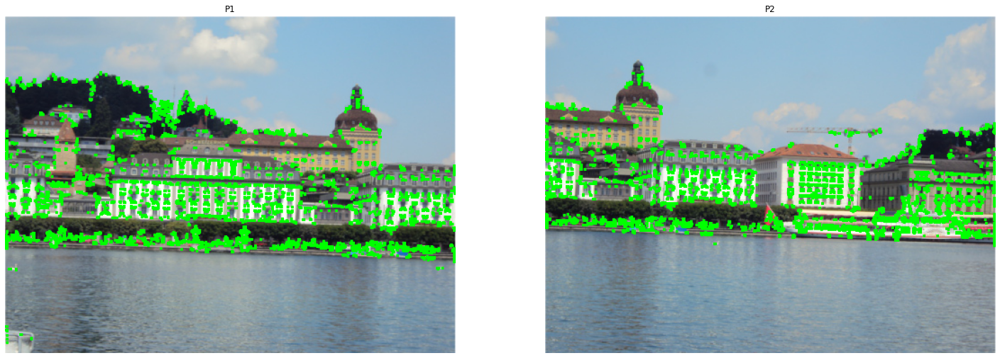

In [18]:

images_gray = [np.float32(rgb2gray(images[3].copy())), np.float32(rgb2gray(images[4].copy()))]
images_copie = [images[3].copy(), images[4].copy()]

dst1 = cv2.cornerHarris(images_gray[0],2,3,0.04)
#result is dilated for marking the corners, not important
dst1 = cv2.dilate(dst1,None)
# Threshold for an optimal value, it may vary depending on the image.
images_copie[0][dst1>0.01*dst1.max()]=[0,255,0]

dst2 = cv2.cornerHarris(images_gray[1],2,3,0.04)
#result is dilated for marking the corners, not important
dst2 = cv2.dilate(dst2,None)
# Threshold for an optimal value, it may vary depending on the image.
images_copie[1][dst2>0.01*dst2.max()]=[0,255,0]

show_images(images_copie, targets=['P1', 'P2'], nb_images=len(images_copie), grid=False, total_cols=2, figsize=(25, 15))


- **Avantages** :
    - Exécution instantané.
    - Haut précision.
    - Stabilité. 

On a toujours le nombre de points renvoyées par le détecteur $Fast$ plus important que le nombre points renvoyées par le détecteur $Harris$.

# EXERCICE 2: DESCRIPTION ET MATCHINGS DES POINTS D’INTERET

L’objectif de cet exercice est d’implementer et d’étudier une méthode de description et de matching des points d’intérét détectés dans l’exercice precédent.

# 1. Description simple : Utilisation d’un bloc d’intensite

$(a)$ Pour chaque point d’interét, récupérer un bloc de pixels autour de celui-ci et transformer le en vecteur.

In [4]:
windows_of_all_images = [   descriptors(img.copy(), harris(img_gray=img.copy(), filter='Gaussian', supression=True)[1], k_size=(9, 9)) 
                            for img in images   ]

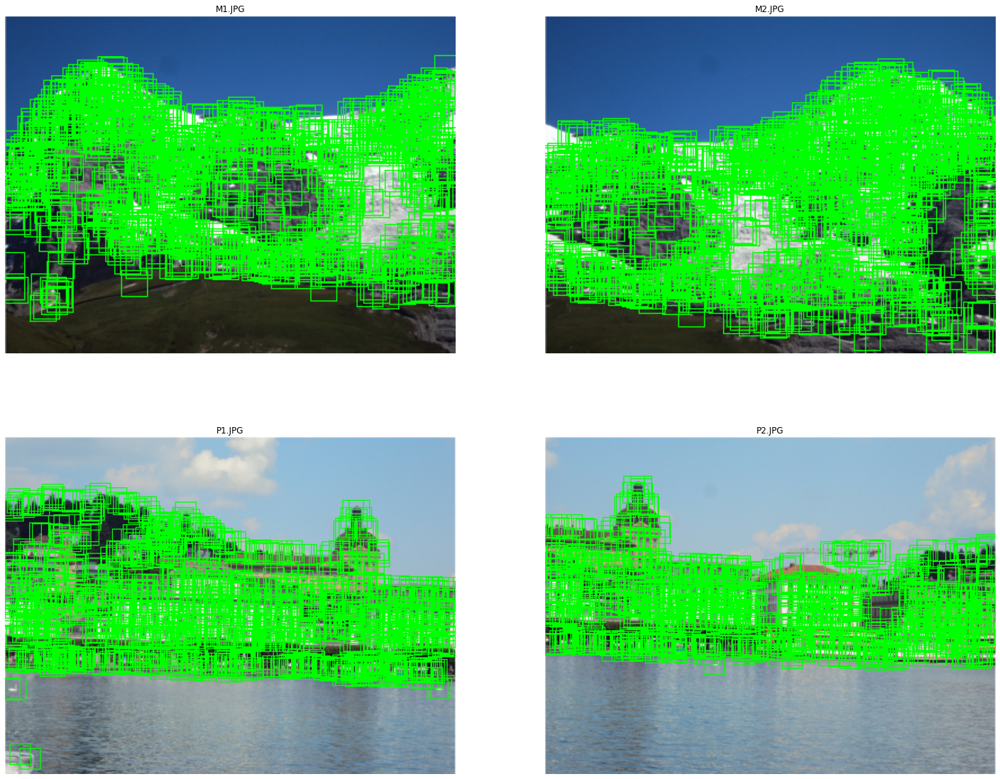

In [5]:

insert_windows_of_all_images  = [   insert_windows_in_the_image(img.copy(), window, k_size=(11, 11), color=((0, 255, 0)))
                                    for img, window in zip(images, windows_of_all_images)   ]

show_images(insert_windows_of_all_images[0:2]+insert_windows_of_all_images[3:5], 
            targets[0:2] + targets[3:5], 
            nb_images=4, 
            grid=False, 
            total_cols=2, 
            figsize=(25, 20)) 

$(b)$ Implementer une méthode de matching capable de gérer les mauvais matchs (soit via un appariement croisé, soit par comparaison des distances)

**Méthode de Matching : comparaison des distances**.
- $1)$ Calcule de la **distance** de chaque descripteur de l'image à l'instant $t$ avec tous les descripteurs de l'image à l'instant $t+1$.
- $2)$ On calcule le rapport des deux distances les plus petites **eps = dist1/dist2**.
    - Si **eps < seuil** ==> Matching réussit.

Tous les descripteurs, qui on matchés serons sauvegardés.



In [6]:
new_windows_png1_png2 = {'M1': None, 'M2': None}
new_windows_png4_png5 = {'P1': None, 'P2': None}

new_windows_png1_png2['M1'], new_windows_png1_png2['M2'] = matching(windows_of_all_images[0].copy(), windows_of_all_images[1].copy(), threshold=0.3) 
new_windows_png4_png5['P1'], new_windows_png4_png5['P2'] = matching(windows_of_all_images[3].copy(), windows_of_all_images[4].copy(), threshold=0.3) 


In [8]:
new_img_windows_png1_png2 = {'M1': None, 'M2': None}
new_img_windows_png4_png5 = {'P1': None, 'P2': None}

new_img_windows_png1_png2['M1']  = insert_windows_in_the_image(images[0], new_windows_png1_png2['M1'], k_size=(9, 9), color=((0, 255, 0)))
new_img_windows_png1_png2['M2']  = insert_windows_in_the_image(images[1], new_windows_png1_png2['M2'], k_size=(9, 9), color=((0, 255, 0)))

new_img_windows_png4_png5['P1']  = insert_windows_in_the_image(images[3], new_windows_png4_png5['P1'], k_size=(9, 9), color=((0, 255, 0)))
new_img_windows_png4_png5['P2']  = insert_windows_in_the_image(images[4], new_windows_png4_png5['P2'], k_size=(9, 9), color=((0, 255, 0)))



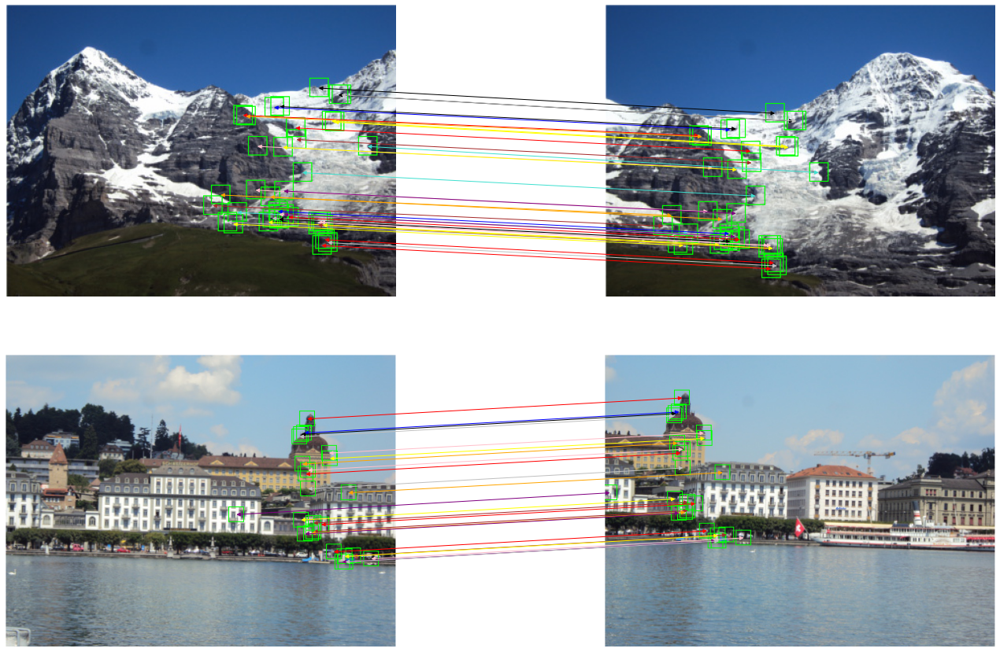

In [9]:
#  Dessiner les caractéristiques correspondantes

fig, axes = plt.subplots(2, 2, figsize=(25, 15))
axes = list(axes.flat)
coordsA = axes[0].transData
coordsB = axes[1].transData
coordsC = axes[2].transData
coordsD = axes[3].transData
colors = ['red', 'orange', 'black', 'yellow', 'blue', 'silver', 'Turquoise', 'pink', 'brown', 'purple'] # green 
axes[0].imshow(new_img_windows_png1_png2['M1']); axes[0].axis(False)
axes[1].imshow(new_img_windows_png1_png2['M2']); axes[1].axis(False)
axes[2].imshow(new_img_windows_png4_png5['P1']); axes[2].axis(False)
axes[3].imshow(new_img_windows_png4_png5['P2']); axes[3].axis(False)
matched_corners1 = list(new_windows_png1_png2['M1'].keys())
matched_corners2 = list(new_windows_png1_png2['M2'].keys())
matched_corners3 = list(new_windows_png4_png5['P1'].keys())
matched_corners4 = list(new_windows_png4_png5['P2'].keys())
for i in range(min(len(matched_corners1), len(matched_corners2))):
    xyA=matched_corners1[i]
    xyB=matched_corners2[i]
    con = ConnectionPatch(np.flip(xyA),np.flip(xyB) , coordsA=coordsA, coordsB=coordsB, arrowstyle="<|-|>", color=np.random.choice(colors))
    fig.add_artist(con)

for i in range(min(len(matched_corners3), len(matched_corners4))):
    xyC=matched_corners3[i]
    xyD=matched_corners4[i]
    con = ConnectionPatch(np.flip(xyC),np.flip(xyD) , coordsA=coordsC, coordsB=coordsD, arrowstyle="<|-|>", color=np.random.choice(colors))
    fig.add_artist(con)
plt.show()

$(c)$ Etudier l’influence de la taille du bloc et des metriques de comparaison utilisées sur la qualité de l’appariement. Pour les metriques, on utilisera la corrélation 
(et on étudiera l’intérét de sa normalisation) ainsi qu’une autre métrique au choix

**Influance de la taille des blocs** :

Dernièrement nous avons utilisés des descripteur de taille $(9, 9)$, pour voir la différance de la taille des bloc nous allons réalisé un Matching avec les images précédentes en prenant cette fois ci la taille des descripteurs $(5, 5)$

In [10]:
windows_of_all_images = [   descriptors(img.copy(), harris(img_gray=img.copy(), filter='Gaussian', supression=True)[1], k_size=(5, 5)) 
                            for img in images   ]

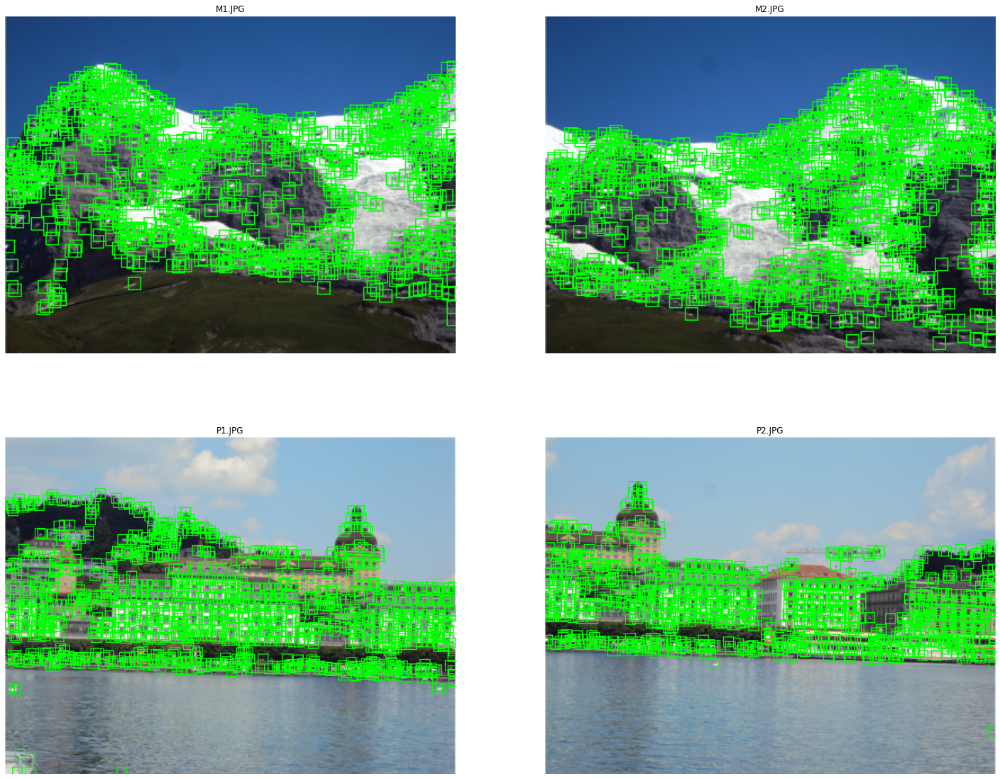

In [11]:

insert_windows_of_all_images  = [   insert_windows_in_the_image(img.copy(), window, k_size=(5, 5), color=((0, 255, 0)))
                                    for img, window in zip(images, windows_of_all_images)   ]

show_images(insert_windows_of_all_images[0:2]+insert_windows_of_all_images[3:5], 
            targets[0:2] + targets[3:5], 
            nb_images=4, 
            grid=False, 
            total_cols=2, 
            figsize=(25, 20)) 

In [15]:
new_windows_png1_png2 = {'M1': None, 'M2': None}
new_windows_png4_png5 = {'P1': None, 'P2': None}

new_windows_png1_png2['M1'], new_windows_png1_png2['M2'] = matching(windows_of_all_images[0].copy(), windows_of_all_images[1].copy()) 
new_windows_png4_png5['P1'], new_windows_png4_png5['P2'] = matching(windows_of_all_images[3].copy(), windows_of_all_images[4].copy()) 


In [16]:
new_img_windows_png1_png2 = {'M1': None, 'M2': None}
new_img_windows_png4_png5 = {'P1': None, 'P2': None}

new_img_windows_png1_png2['M1']  = insert_windows_in_the_image(images[0], new_windows_png1_png2['M1'], k_size=(5, 5), color=((0, 255, 0)))
new_img_windows_png1_png2['M2']  = insert_windows_in_the_image(images[1], new_windows_png1_png2['M2'], k_size=(5, 5), color=((0, 255, 0)))

new_img_windows_png4_png5['P1']  = insert_windows_in_the_image(images[3], new_windows_png4_png5['P1'], k_size=(5, 5), color=((0, 255, 0)))
new_img_windows_png4_png5['P2']  = insert_windows_in_the_image(images[4], new_windows_png4_png5['P2'], k_size=(5, 5), color=((0, 255, 0)))

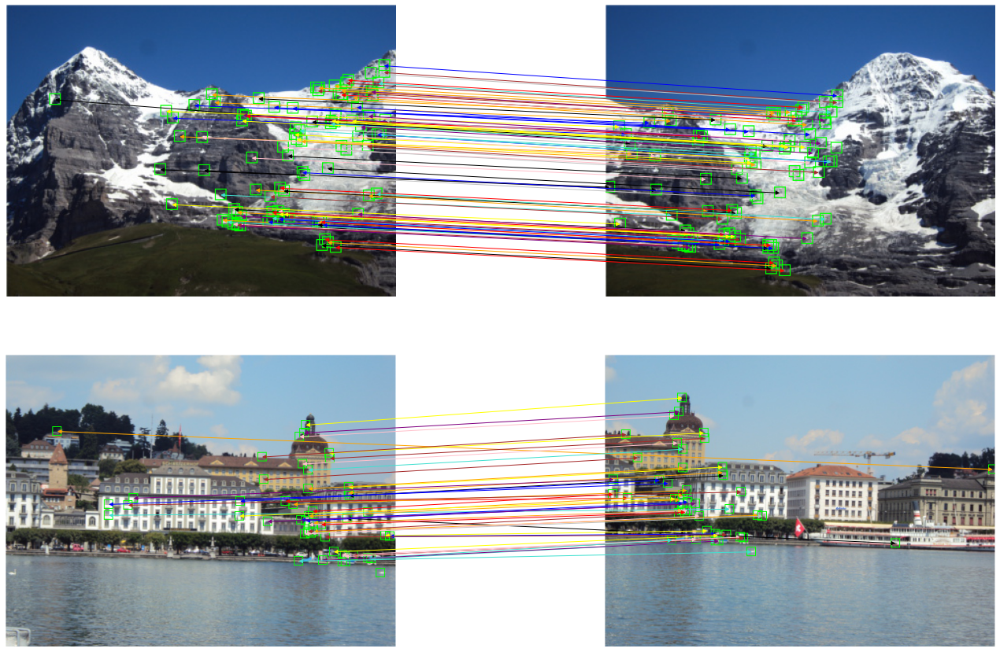

In [17]:
#  Dessiner les caractéristiques correspondantes

fig, axes = plt.subplots(2, 2, figsize=(25, 15))
axes = list(axes.flat)
coordsA = axes[0].transData
coordsB = axes[1].transData
coordsC = axes[2].transData
coordsD = axes[3].transData
colors = ['red', 'orange', 'black', 'yellow', 'blue', 'silver', 'Turquoise', 'pink', 'brown', 'purple'] # green 
axes[0].imshow(new_img_windows_png1_png2['M1']); axes[0].axis(False)
axes[1].imshow(new_img_windows_png1_png2['M2']); axes[1].axis(False)
axes[2].imshow(new_img_windows_png4_png5['P1']); axes[2].axis(False)
axes[3].imshow(new_img_windows_png4_png5['P2']); axes[3].axis(False)
matched_corners1 = list(new_windows_png1_png2['M1'].keys())
matched_corners2 = list(new_windows_png1_png2['M2'].keys())
matched_corners3 = list(new_windows_png4_png5['P1'].keys())
matched_corners4 = list(new_windows_png4_png5['P2'].keys())
for i in range(min(len(matched_corners1), len(matched_corners2))):
    xyA=matched_corners1[i]
    xyB=matched_corners2[i]
    con = ConnectionPatch(np.flip(xyA),np.flip(xyB) , coordsA=coordsA, coordsB=coordsB, arrowstyle="<|-|>", color=np.random.choice(colors))
    fig.add_artist(con)

for i in range(min(len(matched_corners3), len(matched_corners4))):
    xyC=matched_corners3[i]
    xyD=matched_corners4[i]
    con = ConnectionPatch(np.flip(xyC),np.flip(xyD) , coordsA=coordsC, coordsB=coordsD, arrowstyle="<|-|>", color=np.random.choice(colors))
    fig.add_artist(con)
plt.show()

- La taille du bloc correspond à l'enssemble de pixels entourant un point d'intérer, à chaque fois de ce dérnier et grand, on a plus d'informations sur la région du point d'intérer.
- On voie bien dans les affichage précèdent, que à chaque fois que la taille du descripteur est petite en perd des informations, et donc y'a une grande possibilité d'erreur de matching, ce qui explique donc l'apparition de plusieurs fenêtres de faut Matching. 

Jusqu'à présent nous avons estimé le Matching des blocs en calculant la distance $euclidiennes$. Dans ce qui suit  nous allons tester d'autres métriques de calcule de distance, on mètre l'accent plus particulièrement sur la métrique $correlation$.  
**Influance des métriques  $Distance$ $correlation$** :

In [23]:
windows_of_all_images = [   descriptors(img.copy(), harris(img_gray=img.copy(), filter='Gaussian', supression=True)[1], k_size=(9, 9)) 
                            for img in images   ]

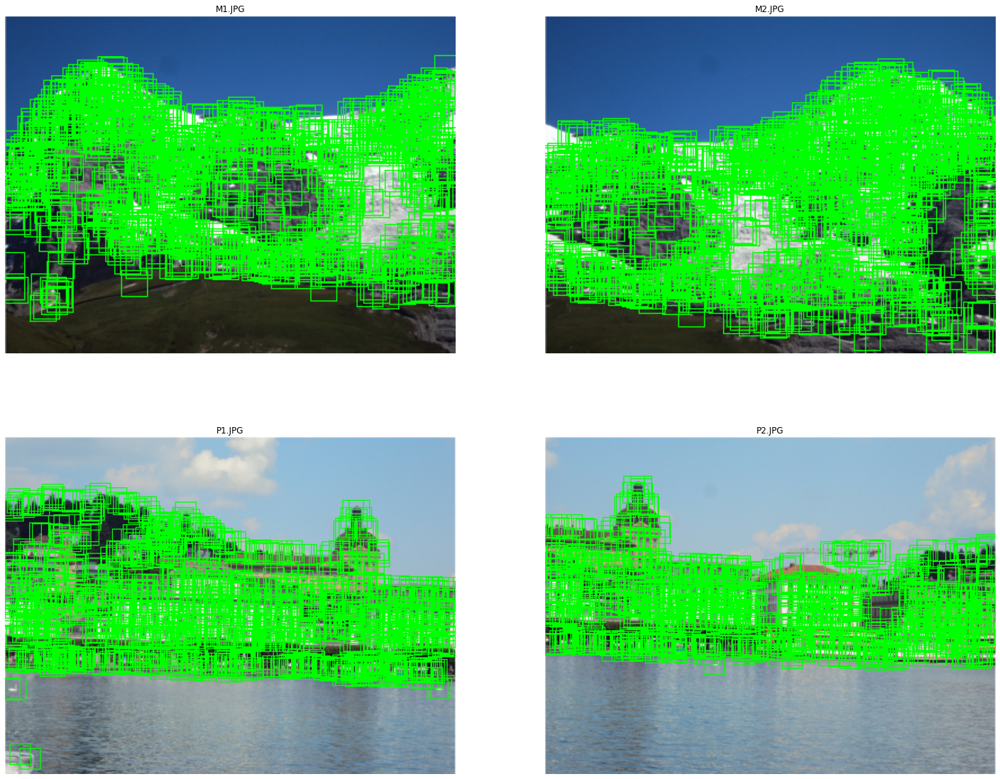

In [24]:
insert_windows_of_all_images  = [   insert_windows_in_the_image(img.copy(), window, k_size=(9, 9), color=((0, 255, 0)))
                                    for img, window in zip(images, windows_of_all_images)   ]

show_images(insert_windows_of_all_images[0:2]+insert_windows_of_all_images[3:5], 
            targets[0:2] + targets[3:5], 
            nb_images=4, 
            grid=False, 
            total_cols=2, 
            figsize=(25, 20)) 

In [25]:
new_windows_png1_png2 = {'M1': None, 'M2': None}
new_windows_png4_png5 = {'P1': None, 'P2': None}

new_windows_png1_png2['M1'], new_windows_png1_png2['M2'] = matching(windows_of_all_images[0].copy(), windows_of_all_images[1].copy(), threshold=0.3, metric='correlation') 
new_windows_png4_png5['P1'], new_windows_png4_png5['P2'] = matching(windows_of_all_images[3].copy(), windows_of_all_images[4].copy(), threshold=0.3, metric='correlation') 


In [26]:
new_img_windows_png1_png2 = {'M1': None, 'M2': None}
new_img_windows_png4_png5 = {'P1': None, 'P2': None}

new_img_windows_png1_png2['M1']  = insert_windows_in_the_image(images[0], new_windows_png1_png2['M1'], k_size=(9, 9), color=((0, 255, 0)))
new_img_windows_png1_png2['M2']  = insert_windows_in_the_image(images[1], new_windows_png1_png2['M2'], k_size=(9, 9), color=((0, 255, 0)))

new_img_windows_png4_png5['P1']  = insert_windows_in_the_image(images[3], new_windows_png4_png5['P1'], k_size=(9, 9), color=((0, 255, 0)))
new_img_windows_png4_png5['P2']  = insert_windows_in_the_image(images[4], new_windows_png4_png5['P2'], k_size=(9, 9), color=((0, 255, 0)))

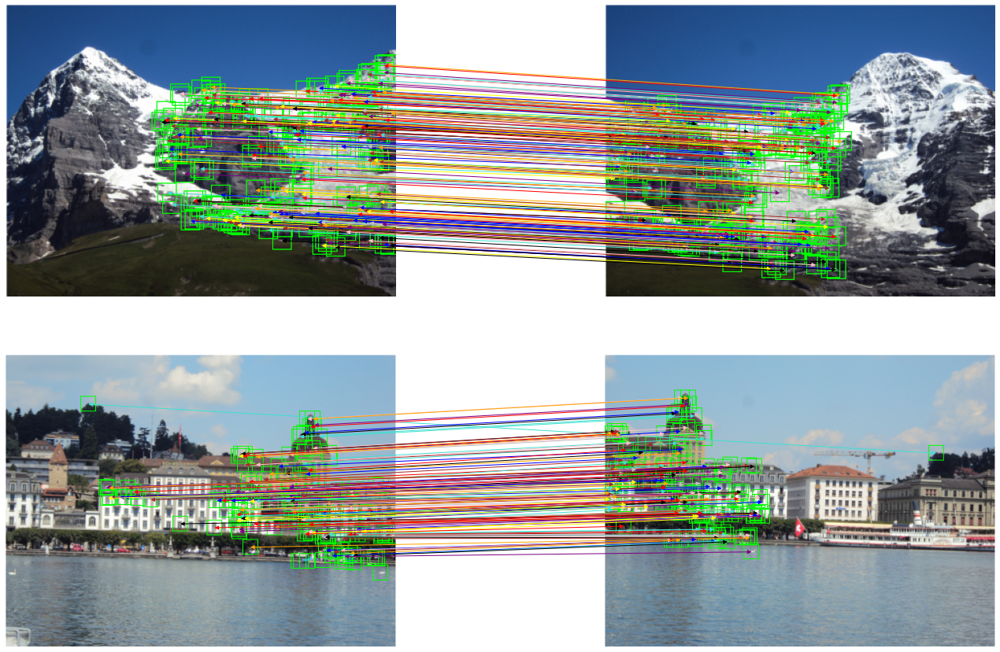

In [27]:
#  Dessiner les caractéristiques correspondantes

fig, axes = plt.subplots(2, 2, figsize=(25, 15))
axes = list(axes.flat)
coordsA = axes[0].transData
coordsB = axes[1].transData
coordsC = axes[2].transData
coordsD = axes[3].transData
colors = ['red', 'orange', 'black', 'yellow', 'blue', 'silver', 'Turquoise', 'pink', 'brown', 'purple'] # green 
axes[0].imshow(new_img_windows_png1_png2['M1']); axes[0].axis(False)
axes[1].imshow(new_img_windows_png1_png2['M2']); axes[1].axis(False)
axes[2].imshow(new_img_windows_png4_png5['P1']); axes[2].axis(False)
axes[3].imshow(new_img_windows_png4_png5['P2']); axes[3].axis(False)
matched_corners1 = list(new_windows_png1_png2['M1'].keys())
matched_corners2 = list(new_windows_png1_png2['M2'].keys())
matched_corners3 = list(new_windows_png4_png5['P1'].keys())
matched_corners4 = list(new_windows_png4_png5['P2'].keys())
for i in range(min(len(matched_corners1), len(matched_corners2))):
    xyA=matched_corners1[i]
    xyB=matched_corners2[i]
    con = ConnectionPatch(np.flip(xyA),np.flip(xyB) , coordsA=coordsA, coordsB=coordsB, arrowstyle="<|-|>", color=np.random.choice(colors))
    fig.add_artist(con)

for i in range(min(len(matched_corners3), len(matched_corners4))):
    xyC=matched_corners3[i]
    xyD=matched_corners4[i]
    con = ConnectionPatch(np.flip(xyC),np.flip(xyD) , coordsA=coordsC, coordsB=coordsD, arrowstyle="<|-|>", color=np.random.choice(colors))
    fig.add_artist(con)
plt.show()

La corrélation croisée calcule la distance entre deux vecteurs, en **normalisant** d'abord ces derniers. Cette approche permet une invariance aux **changements d'intensité de pixel ou de contraste**. Cela explique la détection de plusieurs blocs Matching par rapport a la métrique euclidienne. 


$Correlation = \frac{{}\sum_{i=1}^{n} (x_i - \overline{x})(y_i - \overline{y})}
{\sqrt{\sum_{i=1}^{n} (x_i - \overline{x})^2(y_i - \overline{y})^2}}$

**Influance des métriques  $Distance$ $cosine$** :

In [30]:
new_windows_png1_png2 = {'M1': None, 'M2': None}
new_windows_png4_png5 = {'P1': None, 'P2': None}

new_windows_png1_png2['M1'], new_windows_png1_png2['M2'] = matching(windows_of_all_images[0].copy(), windows_of_all_images[1].copy(), threshold=0.3, metric='cosine') 
new_windows_png4_png5['P1'], new_windows_png4_png5['P2'] = matching(windows_of_all_images[3].copy(), windows_of_all_images[4].copy(), threshold=0.3, metric='cosine') 


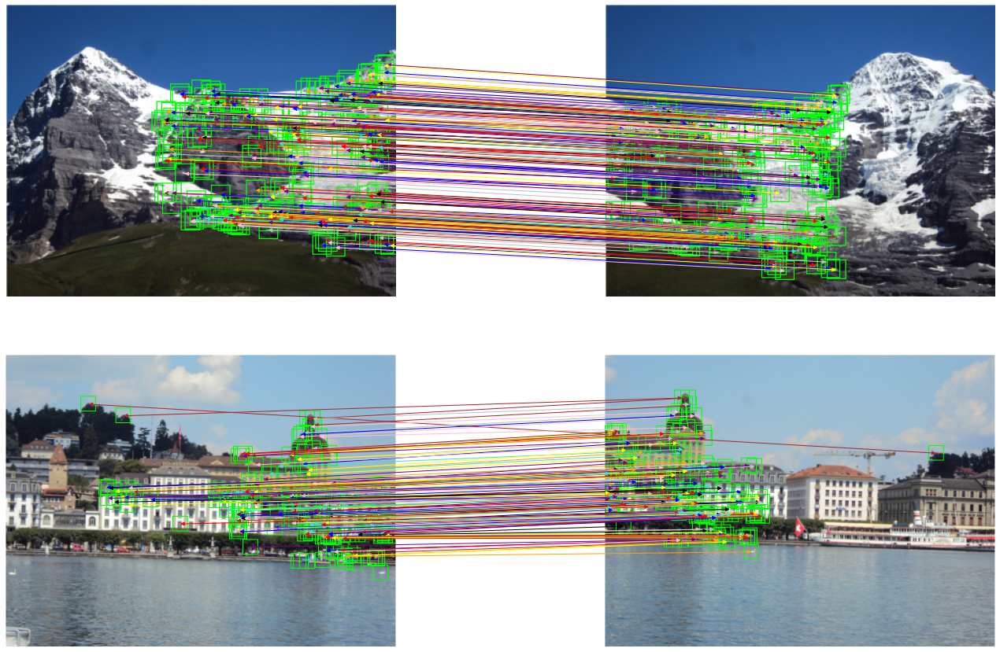

In [31]:
new_img_windows_png1_png2 = {'M1': None, 'M2': None}
new_img_windows_png4_png5 = {'P1': None, 'P2': None}

new_img_windows_png1_png2['M1']  = insert_windows_in_the_image(images[0], new_windows_png1_png2['M1'], k_size=(9, 9), color=((0, 255, 0)))
new_img_windows_png1_png2['M2']  = insert_windows_in_the_image(images[1], new_windows_png1_png2['M2'], k_size=(9, 9), color=((0, 255, 0)))

new_img_windows_png4_png5['P1']  = insert_windows_in_the_image(images[3], new_windows_png4_png5['P1'], k_size=(9, 9), color=((0, 255, 0)))
new_img_windows_png4_png5['P2']  = insert_windows_in_the_image(images[4], new_windows_png4_png5['P2'], k_size=(9, 9), color=((0, 255, 0)))

#  Dessiner les caractéristiques correspondantes

fig, axes = plt.subplots(2, 2, figsize=(25, 15))
axes = list(axes.flat)
coordsA = axes[0].transData
coordsB = axes[1].transData
coordsC = axes[2].transData
coordsD = axes[3].transData
colors = ['red', 'orange', 'black', 'yellow', 'blue', 'silver', 'Turquoise', 'pink', 'brown', 'purple'] # green 
axes[0].imshow(new_img_windows_png1_png2['M1']); axes[0].axis(False)
axes[1].imshow(new_img_windows_png1_png2['M2']); axes[1].axis(False)
axes[2].imshow(new_img_windows_png4_png5['P1']); axes[2].axis(False)
axes[3].imshow(new_img_windows_png4_png5['P2']); axes[3].axis(False)
matched_corners1 = list(new_windows_png1_png2['M1'].keys())
matched_corners2 = list(new_windows_png1_png2['M2'].keys())
matched_corners3 = list(new_windows_png4_png5['P1'].keys())
matched_corners4 = list(new_windows_png4_png5['P2'].keys())
for i in range(min(len(matched_corners1), len(matched_corners2))):
    xyA=matched_corners1[i]
    xyB=matched_corners2[i]
    con = ConnectionPatch(np.flip(xyA),np.flip(xyB) , coordsA=coordsA, coordsB=coordsB, arrowstyle="<|-|>", color=np.random.choice(colors))
    fig.add_artist(con)

for i in range(min(len(matched_corners3), len(matched_corners4))):
    xyC=matched_corners3[i]
    xyD=matched_corners4[i]
    con = ConnectionPatch(np.flip(xyC),np.flip(xyD) , coordsA=coordsC, coordsB=coordsD, arrowstyle="<|-|>", color=np.random.choice(colors))
    fig.add_artist(con)
plt.show()

La distance cosinus entre les vecteurs $u$ et $v$.

$(d)$ Utiliser les fonctions existantes de Matlab ou Python pour effectuer une rotation de l’une des images. Les appariements
obtenus sont-ils les memes que précédemment ? Implementer une solution permettant de gérer ce probléme

In [35]:
windows_of_all_images = [   descriptors(img.copy(), harris(img_gray=img.copy(), filter='Gaussian', supression=True)[1], k_size=(7, 7)) 
                            for img in images_rotated   ]

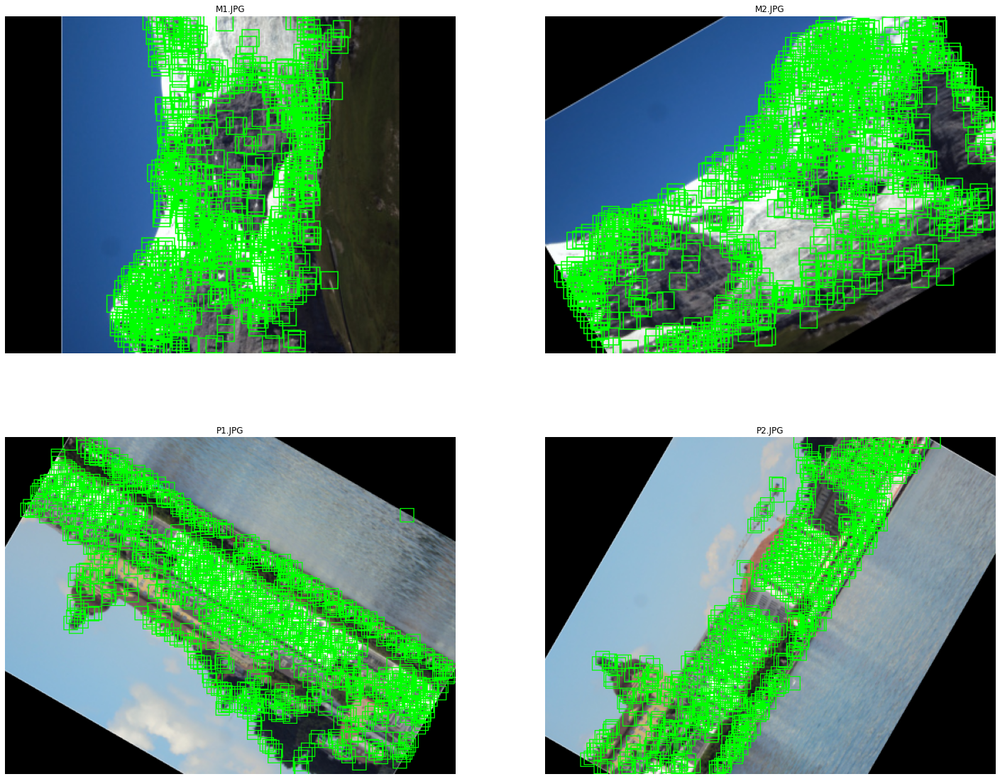

In [36]:

insert_windows_of_all_images  = [   insert_windows_in_the_image(img.copy(), window, k_size=(7, 7), color=((0, 255, 0)))
                                    for img, window in zip(images_rotated, windows_of_all_images)   ]

show_images(insert_windows_of_all_images[0:2]+insert_windows_of_all_images[3:5], 
            targets[0:2] + targets[3:5], 
            nb_images=4, 
            grid=False, 
            total_cols=2, 
            figsize=(25, 20)) 

In [37]:
new_windows_png1_png2 = {'M1': None, 'M2': None}
new_windows_png4_png5 = {'P1': None, 'P2': None}

new_windows_png1_png2['M1'], new_windows_png1_png2['M2'] = matching(windows_of_all_images[0].copy(), windows_of_all_images[1].copy(), threshold=0.3, metric='correlation') 
new_windows_png4_png5['P1'], new_windows_png4_png5['P2'] = matching(windows_of_all_images[3].copy(), windows_of_all_images[4].copy(), threshold=0.3, metric='correlation') 


In [38]:
new_img_windows_png1_png2 = {'M1': None, 'M2': None}
new_img_windows_png4_png5 = {'P1': None, 'P2': None}

new_img_windows_png1_png2['M1']  = insert_windows_in_the_image(images_rotated[0], new_windows_png1_png2['M1'], k_size=(7, 7), color=((0, 255, 0)))
new_img_windows_png1_png2['M2']  = insert_windows_in_the_image(images_rotated[1], new_windows_png1_png2['M2'], k_size=(7, 7), color=((0, 255, 0)))

new_img_windows_png4_png5['P1']  = insert_windows_in_the_image(images_rotated[3], new_windows_png4_png5['P1'], k_size=(7, 7), color=((0, 255, 0)))
new_img_windows_png4_png5['P2']  = insert_windows_in_the_image(images_rotated[4], new_windows_png4_png5['P2'], k_size=(7, 7), color=((0, 255, 0)))

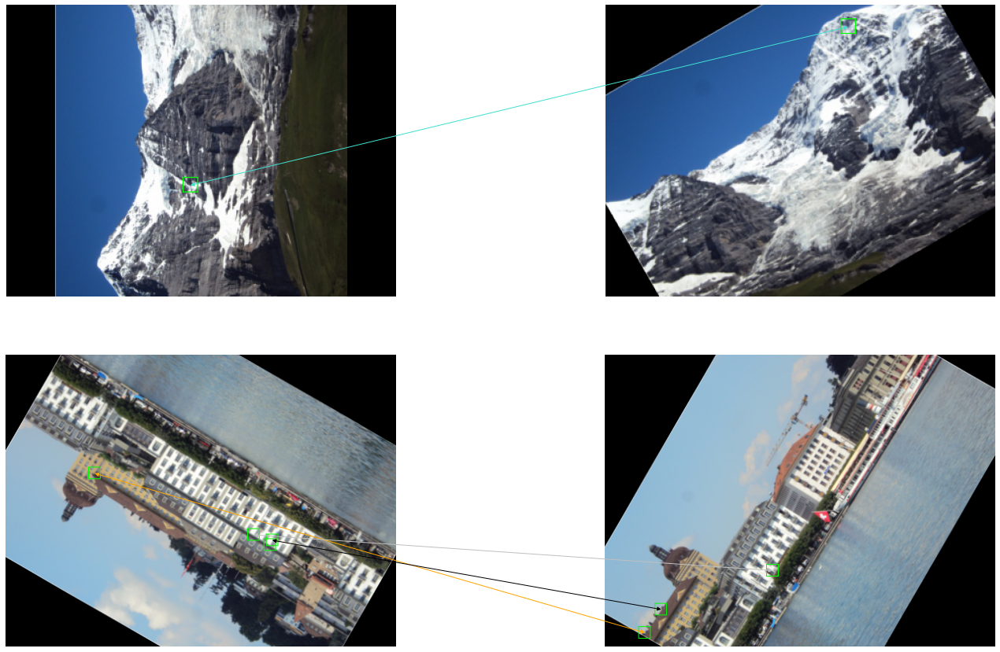

In [39]:
#  Dessiner les caractéristiques correspondantes

fig, axes = plt.subplots(2, 2, figsize=(25, 15))
axes = list(axes.flat)
coordsA = axes[0].transData
coordsB = axes[1].transData
coordsC = axes[2].transData
coordsD = axes[3].transData
colors = ['red', 'orange', 'black', 'yellow', 'blue', 'silver', 'Turquoise', 'pink', 'brown', 'purple'] # green 
axes[0].imshow(new_img_windows_png1_png2['M1']); axes[0].axis(False)
axes[1].imshow(new_img_windows_png1_png2['M2']); axes[1].axis(False)
axes[2].imshow(new_img_windows_png4_png5['P1']); axes[2].axis(False)
axes[3].imshow(new_img_windows_png4_png5['P2']); axes[3].axis(False)
matched_corners1 = list(new_windows_png1_png2['M1'].keys())
matched_corners2 = list(new_windows_png1_png2['M2'].keys())
matched_corners3 = list(new_windows_png4_png5['P1'].keys())
matched_corners4 = list(new_windows_png4_png5['P2'].keys())
for i in range(min(len(matched_corners1), len(matched_corners2))):
    xyA=matched_corners1[i]
    xyB=matched_corners2[i]
    con = ConnectionPatch(np.flip(xyA),np.flip(xyB) , coordsA=coordsA, coordsB=coordsB, arrowstyle="<|-|>", color=np.random.choice(colors))
    fig.add_artist(con)

for i in range(min(len(matched_corners3), len(matched_corners4))):
    xyC=matched_corners3[i]
    xyD=matched_corners4[i]
    con = ConnectionPatch(np.flip(xyC),np.flip(xyD) , coordsA=coordsC, coordsB=coordsD, arrowstyle="<|-|>", color=np.random.choice(colors))
    fig.add_artist(con)
plt.show()

Lors de l'application des rotations au images, le Matching a données un résultat qui ne resemble pas du tous à ce que on avais avant, la raison est que nos descripteurs non subits aucune rotation! donc les informations contenus dans ces derniers sont corrompus ==> les distances calculées entres chaque descripteur sont aussi fausses.    

Le descripteur simple n'est pas invariant en rotation.

**Solution:** Méthode du gradient.
- Calculez l'histogramme du gradient de chaque descripteur. (soit avec la fonction `kimage.feature.hog`, soit en calculant le gradient sur x et y puis en déduisant la magnitude et l'angle de chaque pixel du descripteur.
- On déduit l'angle de rotation du pixel ayant la plus grande amplitude.
- On réoriente les descripteurs en fonction de cet angle.
- Avec cette méthode, la correspondance sera invariante aux rotations.